## Initial

In [69]:
# deep learning framework and array libraries
import torch
from torch import nn 
import numpy as np

# plotting
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# gif animation
import imageio
import glob
from IPython.display import Image

Set the random seed so that anyone on a different machine will see the same results.

In [70]:
torch.manual_seed(111)

## Training data

Create a sphere of points for the generator model to learn.

In [71]:
def sphere_points(samples):

    points = np.zeros((samples,3))
    phi = np.pi * (3. - np.sqrt(5.))  # golden angle in radians

    for i in range(samples):
        y = 1 - (i / float(samples - 1)) * 2  # y goes from 1 to -1
        radius = np.sqrt(1 - y * y)  # radius at y

        theta = phi * i  # golden angle increment

        x = np.cos(theta) * radius
        z = np.sin(theta) * radius

        points[i] = (x, y, z)

    return points
  
train_data_length = 1024
train_data = sphere_points(train_data_length)
train_labels = torch.zeros(train_data_length)

train_set = [
             (train_data[i], train_labels[i]) for i in range(train_data_length)
]

batch_size = 32
train_loader = torch.utils.data.DataLoader(
    train_set, batch_size=batch_size, shuffle=True
)

## Discriminator and Generator

In [72]:
class Discriminator(nn.Module):
    def __init__(self):
        super().__init__()
        self.model = nn.Sequential(
            nn.Linear(3, 256), # input: coordinates (x, y, z)
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(256, 128),
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(128, 64),
            nn.ReLU(),
            nn.Dropout(0.3),
            nn.Linear(64, 1),
            nn.Sigmoid(), # output: classification of point
        )

    def forward(self, x):
        # give inputs to model, return output
        output = self.model(x)
        return output

class Generator(nn.Module):
    def __init__(self):
        super().__init__()
        self.model = nn.Sequential(
            nn.Linear(3, 32), # input: latent point (x, y, z)
            nn.ReLU(),
            nn.Linear(32, 64),
            nn.ReLU(),
            nn.Linear(64, 3), # output: coordinates (x, y, z)
        )

    def forward(self, x):
        # give inputs to model, return output
        output = self.model(x)
        return output

discriminator = Discriminator()
generator = Generator()

## Train the GAN

In [73]:
lr = 0.001
num_epochs = 500
loss_function = nn.BCELoss()

optimizer_discriminator = torch.optim.Adam(discriminator.parameters(), lr=lr)
optimizer_generator = torch.optim.Adam(generator.parameters(), lr=lr)

Epoch: 0 Loss D.: 0.4969634711742401
Epoch: 0 Loss G.: 1.2053979635238647
Epoch: 50 Loss D.: 0.648999810218811
Epoch: 50 Loss G.: 0.7210043668746948
Epoch: 100 Loss D.: 0.6981551647186279
Epoch: 100 Loss G.: 0.73295658826828
Epoch: 150 Loss D.: 0.6908321380615234
Epoch: 150 Loss G.: 0.6966730952262878
Epoch: 200 Loss D.: 0.6862493753433228
Epoch: 200 Loss G.: 0.6884066462516785
Epoch: 250 Loss D.: 0.6882653832435608
Epoch: 250 Loss G.: 0.6830211877822876
Epoch: 300 Loss D.: 0.6810535788536072
Epoch: 300 Loss G.: 0.7408599257469177
Epoch: 350 Loss D.: 0.6690803170204163
Epoch: 350 Loss G.: 0.8093227744102478
Epoch: 400 Loss D.: 0.6773041486740112
Epoch: 400 Loss G.: 0.6892039775848389
Epoch: 450 Loss D.: 0.68003910779953
Epoch: 450 Loss G.: 0.6889112591743469


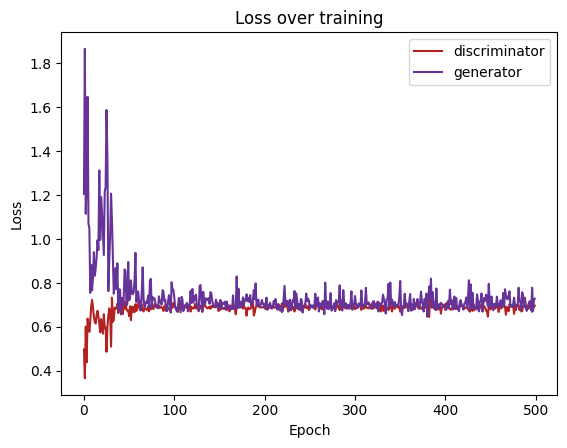

In [74]:
def train():

  plt.figure(figsize=(6.4,4.8), dpi=100)
  train_data = np.zeros((num_epochs, 2))

  # store generated spheres from each epoch
  all_generated_samples = np.zeros((num_epochs, 1024, 3))

  for epoch in range(num_epochs):
      for n, (real_samples, _) in enumerate(train_loader):
         
          # ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~ DISCRIMINATOR 
          # Get data for discriminator
          real_samples_labels = torch.ones((batch_size, 1))

          latent_space_samples = torch.randn((batch_size, 3))
          generated_samples = generator(latent_space_samples)
          generated_samples_labels = torch.zeros((batch_size, 1))

          # mix real (training) and fake (generated) data
          all_samples = torch.cat((real_samples, generated_samples))
          all_samples_labels = torch.cat(
              (real_samples_labels, generated_samples_labels)
          )

          # Training the discriminator
          discriminator.zero_grad()
          output_discriminator = discriminator(all_samples.float())
          loss_discriminator = loss_function(
              output_discriminator, all_samples_labels)
          loss_discriminator.backward()
          optimizer_discriminator.step()

          # ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

          # ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~ GENERATOR
          # Get data for generator
          latent_space_samples = torch.randn((batch_size, 3))

          # Training the generator
          generator.zero_grad()
          generated_samples = generator(latent_space_samples)
          output_discriminator_generated = discriminator(generated_samples)
          loss_generator = loss_function(
              output_discriminator_generated, real_samples_labels
          )
          loss_generator.backward()
          optimizer_generator.step()
          # ~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~

          # Show loss
          if epoch % 100 == 0 and n == batch_size - 1:
              print(f"Epoch: {epoch} Loss D.: {loss_discriminator}")
              print(f"Epoch: {epoch} Loss G.: {loss_generator}")

      # generate sphere from each epoch
      latent_space_samples = torch.randn(1024, 3)
      all_generated_samples[epoch] = generator(
          latent_space_samples
        ).detach().numpy()

      # losses from epoch
      train_data[epoch] = (loss_discriminator, loss_generator)

  plt.title('Loss over training')
  plt.ylabel('Loss')
  plt.xlabel('Epoch')
  plt.plot(range(num_epochs), train_data[:,0], 
           color='firebrick', label='discriminator')
  plt.plot(range(num_epochs), train_data[:,1], 
           color='rebeccapurple', label='generator')
  plt.legend(loc='best')

  return all_generated_samples

all_generated_samples = train()

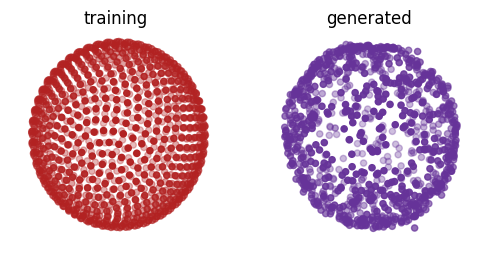

In [75]:
latent_space_samples = torch.randn(1024, 3)
generated_samples = generator(latent_space_samples)

generated_samples = generated_samples.detach()

def plot_points(ax, points, c):
  # plot a sphere on a figure's axis.
  ax.scatter(points[:,0], points[:,1], points[:,2], color=c)
  ax.axis('off')
  ax.dist = 6

def plot_3d():
  fig = plt.figure(figsize=(6.,3.), dpi=100)

  ax1 = fig.add_subplot(121, projection='3d')
  ax1.set_title('training', y=1.05)
  plot_points(ax1, train_data, 'firebrick')
  
  ax2 = fig.add_subplot(122, projection='3d')
  ax2.set_title('generated', y=1.05)
  plot_points(ax2, generated_samples, 'rebeccapurple')

def plot_2d():
  fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(6,3))
  ax1.plot(train_data[:,0],
          train_data[:,1],
          linestyle='', 
          marker='o',
          color='firebrick',
          alpha=0.7)
  ax2.plot(generated_samples[:,0], 
          generated_samples[:,1], 
          linestyle='', 
          marker='o',
          color='rebeccapurple',
          alpha=0.7)
  plt.axis('off')

plot_3d()

## GAN learning

So what actually happened?

Let's look at the series of images we collected during training...

In [76]:
def save_plot_points(points, i):
  # plot a 'frame' for each epoch of the generator learning process

  fig = plt.figure(figsize=(3,3), dpi=100)
  ax = fig.add_subplot(111, projection='3d')
  ax.set_title('epoch {:04d}'.format(i), y=1.05)

  ax.scatter(train_data[:,0], 
             train_data[:,1], 
             train_data[:,2], 
             alpha=0.35,
             color='firebrick')
  ax.scatter(points[:,0], 
             points[:,1], 
             points[:,2],
             color='rebeccapurple')
  
  lims = [-1.2, 1.2]
  ax.set_xlim3d(lims)
  ax.set_ylim3d(lims)
  ax.set_zlim3d(lims)

  ax.axis('off')
  ax.dist = 6
  plt.savefig('image_{:04d}.png'.format(i))
  plt.close()

# save each frame we collected in training
for i in range(all_generated_samples.shape[0]):
  save_plot_points(all_generated_samples[i], i)

Now we can make an animated `.gif ` file to show how the generator approximated the sphere throught its learning.

In [77]:
# make the actual '.gif' animation file.

def display_image(epoch_no):
  return PIL.Image.open('image_{:04d}.png'.format(epoch_no))

anim_file = 'gan.gif'

with imageio.get_writer(anim_file, mode='I') as writer:
  filenames = glob.glob('image*.png')
  filenames = sorted(filenames)

  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)

  image = imageio.imread(filename)
  writer.append_data(image)

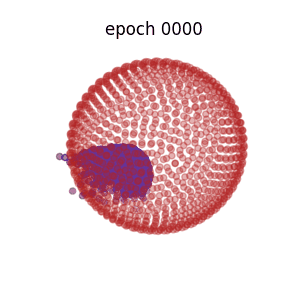

In [78]:
Image(open(anim_file, 'rb').read())

In [79]:
# optional download
download = False
if download:
  from google.colab import files
  files.download(anim_file) 